In [1]:
df = pd.read_csv('2_new.csv')
df.tail()

,Unnamed: 0,Category,Rating,reviews,Size,Installs,Type,Price,Content Rating,Genres,pri_genres,sec_genres,Current_Ver,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver
10834,10834,FAMILY,4.5,38.0,53.0,5000.0,0.0,0.0,Everyone,Education,Education,Education,1.48,7.0,2017.0,4.0,11.0
10835,10835,FAMILY,5.0,4.0,3.6,100.0,0.0,0.0,Everyone,Education,Education,Education,1.0,7.0,2018.0,4.0,11.0
10836,10836,MEDICAL,0.0,3.0,9.5,1000.0,0.0,0.0,Everyone,Medical,Medical,Medical,1.0,1.0,2017.0,2.0,11.0
10837,10837,BOOKS_AND_REFERENCE,4.5,114.0,37.0,1000.0,0.0,0.0,Mature 17+,Books & Reference,Books & Reference,Books & Reference,1.0.0,1.0,2015.0,11.0,11.0
10838,10838,LIFESTYLE,4.5,398307.0,19.0,10000000.0,0.0,0.0,Everyone,Lifestyle,Lifestyle,Lifestyle,1.0.0,7.0,2018.0,11.0,11.0


In [2]:
df['Installs_log'] = np.log10(df.Installs)
df.tail()

C:\Users\Gk\anaconda3\lib\site-packages\pandas\core\series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


,Unnamed: 0,Category,Rating,reviews,Size,Installs,Type,Price,Content Rating,Genres,pri_genres,sec_genres,Current_Ver,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10834,10834,FAMILY,4.5,38.0,53.0,5000.0,0.0,0.0,Everyone,Education,Education,Education,1.48,7.0,2017.0,4.0,11.0,3.69897
10835,10835,FAMILY,5.0,4.0,3.6,100.0,0.0,0.0,Everyone,Education,Education,Education,1.0,7.0,2018.0,4.0,11.0,2.00000
10836,10836,MEDICAL,0.0,3.0,9.5,1000.0,0.0,0.0,Everyone,Medical,Medical,Medical,1.0,1.0,2017.0,2.0,11.0,3.00000
10837,10837,BOOKS_AND_REFERENCE,4.5,114.0,37.0,1000.0,0.0,0.0,Mature 17+,Books & Reference,Books & Reference,Books & Reference,1.0.0,1.0,2015.0,11.0,11.0,3.00000
10838,10838,LIFESTYLE,4.5,398307.0,19.0,10000000.0,0.0,0.0,Everyone,Lifestyle,Lifestyle,Lifestyle,1.0.0,7.0,2018.0,11.0,11.0,7.00000


In [3]:
df['Installs_log'].unique()

array([4.     , 5.69897, 6.69897, 7.69897, 5.     , 4.69897, 6.     ,
       7.     , 3.69897, 8.     , 9.     , 3.     , 8.69897, 1.69897,
       2.     , 2.69897, 1.     , 0.     , 0.69897,    -inf])

In [4]:
df.loc[df.Installs_log == float('-inf')] = 0

### Install의 Log 값 기반 분석

count    10839.000000
mean         4.881463
std          1.974904
min          0.000000
25%          3.349485
50%          5.000000
75%          6.698970
max          9.000000
Name: Installs_log, dtype: float64


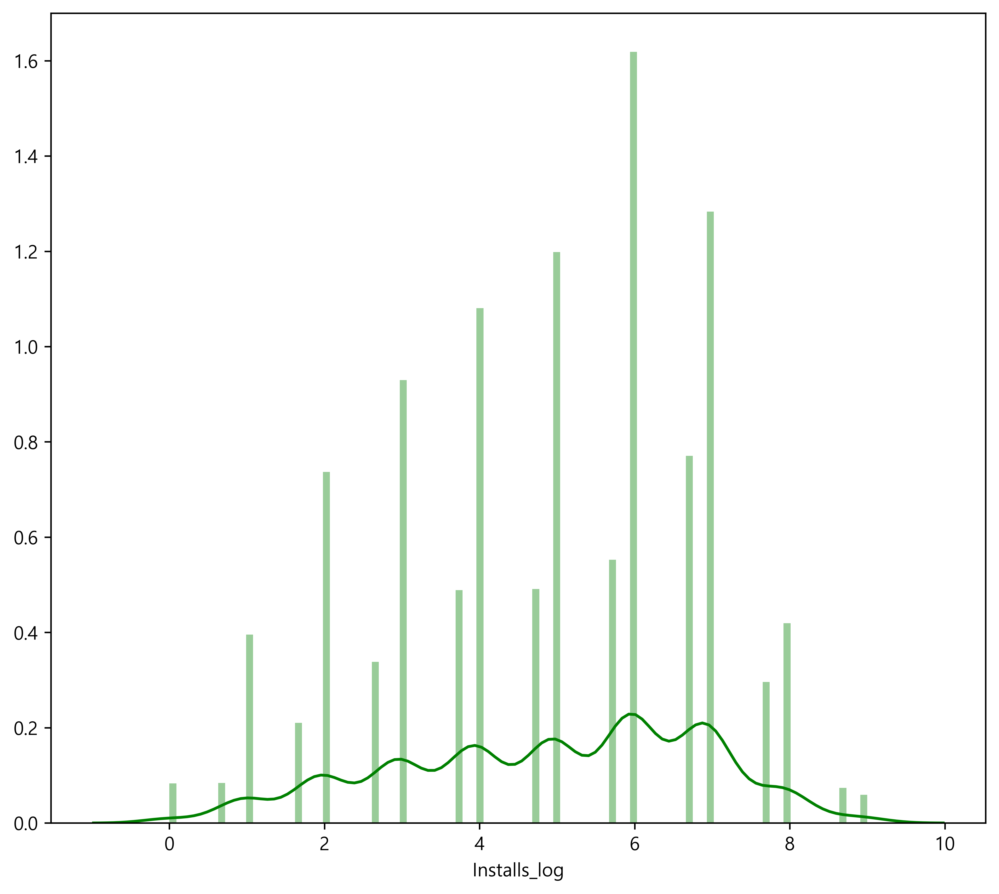

In [5]:
print(df['Installs_log'].describe())
plt.figure(figsize=(9, 8))
sns.distplot(df['Installs_log'], color='g', bins=100, hist_kws={'alpha': 0.4});

In [6]:
# float64와 int64로 이루어진 데이터 타입 확인
df_num = df.select_dtypes(include = ['float64', 'int64'])
df_num.head()

,Unnamed: 0,Rating,reviews,Size,Installs,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
0,0,4.1,159.0,19.0,10000.0,0.0,0.0,1.0,2018.0,4.0,11.0,4.00000
1,1,3.9,967.0,14.0,500000.0,0.0,0.0,1.0,2018.0,4.0,11.0,5.69897
2,2,4.7,87510.0,8.7,5000000.0,0.0,0.0,8.0,2018.0,4.0,11.0,6.69897
3,3,4.5,215644.0,25.0,50000000.0,0.0,0.0,6.0,2018.0,4.0,11.0,7.69897
4,4,4.3,967.0,2.8,100000.0,0.0,0.0,6.0,2018.0,4.0,11.0,5.00000


In [7]:
col = ['Rating', 'reviews', 'Size', 'Type', 'Price', 'Ver_Mon', 'Ver_Year', 'And_1st_Ver', 'And_Last_Ver', 'Installs_log']

df_1 = df[col]
df_1.tail(1)

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10838,4.5,398307.0,19.0,0.0,0.0,7.0,2018.0,11.0,11.0,7.0


In [8]:
df_1.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [9]:
df_1_corr = df_1.corr()['Installs_log'][:-1] # 마지막 col이 Install이라 -1까지만
features_list = df_1_corr[abs(df_1_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Installs_log:\n{}".format(len(features_list), features_list))

The following are the top 9 strongly correlated values with Installs_log:
Rating          0.586801
And_1st_Ver     0.325531
reviews         0.254668
Ver_Mon         0.103135
Ver_Year        0.091992
And_Last_Ver    0.084122
Size           -0.000768
Price          -0.046416
Type           -0.237945
Name: Installs_log, dtype: float64


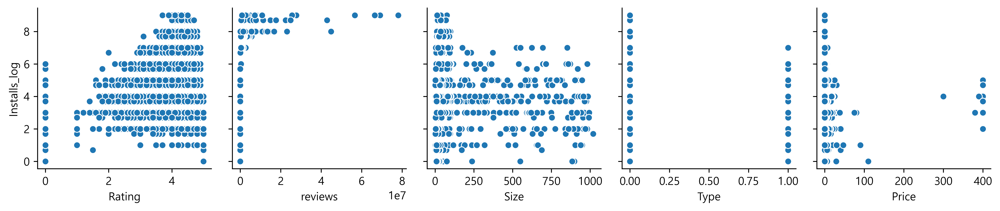

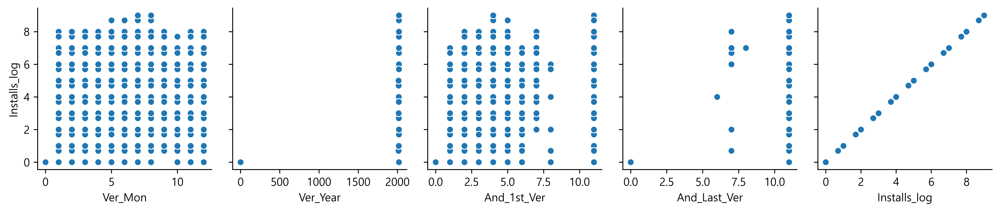

In [10]:
for i in range(0, len(df_1.columns), 5):
    sns.pairplot(data=df_1,
                 x_vars=df_1.columns[i:i+5],
                 y_vars=['Installs_log']
                )

In [11]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Installs_log', data=df_1[col], ax=ax)

In [12]:
sns.set(style="ticks", color_codes="True")
g = sns.pairplot(df_1, hue="Type")

C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)
C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:369: UserWarning: Default bandwidth for data is 0; skipping density estimation.
  warnings.warn(msg, UserWarning)
C:\Users\Gk\anaconda3\lib\site-packages\seaborn\distributions.py:283: UserWarning: Data must have variance to compute a kernel density estimate.
  warnings.warn(msg, UserWarning)


### 유료 앱

In [13]:
df_paid = df_1.loc[df_1.Price != 0]
df_paid.tail()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10733,0.0,17.0,157.0,1.0,0.99,11.0,2015.0,2.0,11.0,2.00000
10758,4.4,35.0,2.4,1.0,7.99,8.0,2018.0,4.0,11.0,3.00000
10780,3.8,252.0,11.0,1.0,16.99,2.0,2015.0,5.0,11.0,4.00000
10783,4.2,1405.0,9.5,1.0,1.20,6.0,2018.0,2.0,11.0,4.00000
10796,0.0,0.0,1020.0,1.0,1.04,2.0,2012.0,3.0,11.0,1.69897


In [14]:
df_paid.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [15]:
df_p_corr = df_paid.corr()['Installs_log'][:-1]
features_list = df_p_corr[abs(df_p_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Installs_log:\n{}".format(len(features_list), features_list))

The following are the top 7 strongly correlated values with Installs_log:
Rating         0.624284
reviews        0.210473
And_1st_Ver    0.177113
Ver_Year       0.091757
Ver_Mon        0.051573
Price          0.031493
Size          -0.065092
Name: Installs_log, dtype: float64


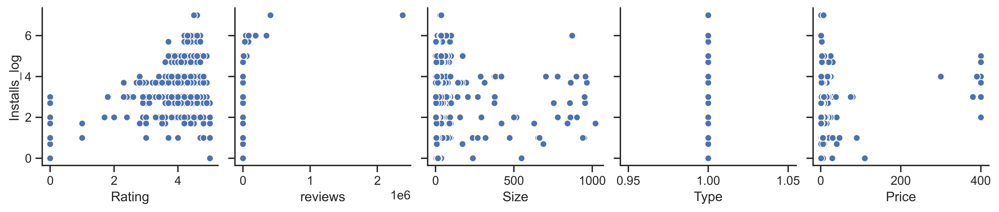

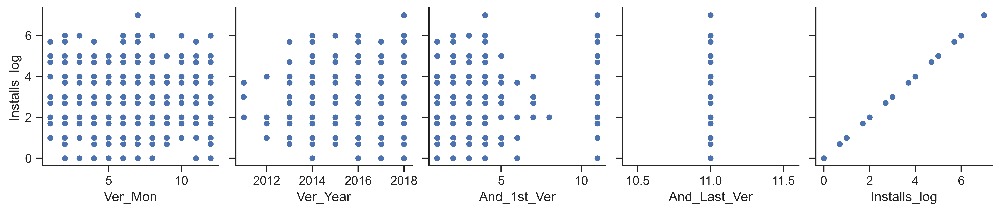

In [16]:
for i in range(0, len(df_paid.columns), 5):
    sns.pairplot(data=df_paid,
                 x_vars=df_paid.columns[i:i+5],
                 y_vars=['Installs_log']
                )

In [17]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Installs_log', data=df_paid[col], ax=ax)

In [18]:
len(df_paid)

790

In [19]:
df_paid.describe()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
count,790.000000,7.900000e+02,790.000000,790.0,790.000000,790.000000,790.000000,790.000000,784.0,790.000000
mean,3.494304,1.182108e+04,57.218734,1.0,12.571215,6.379747,2016.684810,3.991139,11.0,3.205552
std,1.716846,1.218219e+05,148.723218,0.0,53.552404,3.045509,1.555284,2.423203,0.0,1.447694
min,0.000000,0.000000e+00,1.000000,1.0,0.990000,1.000000,2011.000000,1.000000,11.0,0.000000
25%,3.500000,8.000000e+00,5.425000,1.0,1.490000,4.000000,2016.000000,2.000000,11.0,2.000000
50%,4.300000,1.140000e+02,20.000000,1.0,2.990000,6.000000,2017.000000,4.000000,11.0,3.000000
75%,4.600000,1.372750e+03,37.000000,1.0,4.990000,8.000000,2018.000000,4.000000,11.0,4.000000
max,5.000000,2.376564e+06,1020.000000,1.0,400.000000,12.000000,2018.000000,11.000000,11.0,7.000000


### $250 이하

In [20]:
df_paid_2 = df_paid.loc[df_paid.Price < 250]
df_paid_2.tail()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10733,0.0,17.0,157.0,1.0,0.99,11.0,2015.0,2.0,11.0,2.00000
10758,4.4,35.0,2.4,1.0,7.99,8.0,2018.0,4.0,11.0,3.00000
10780,3.8,252.0,11.0,1.0,16.99,2.0,2015.0,5.0,11.0,4.00000
10783,4.2,1405.0,9.5,1.0,1.20,6.0,2018.0,2.0,11.0,4.00000
10796,0.0,0.0,1020.0,1.0,1.04,2.0,2012.0,3.0,11.0,1.69897


In [21]:
df_paid_2.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [22]:
df_paid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 790 entries, 234 to 10796
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Rating        790 non-null    float64
 1   reviews       790 non-null    float64
 2   Size          790 non-null    float64
 3   Type          790 non-null    float64
 4   Price         790 non-null    float64
 5   Ver_Mon       790 non-null    float64
 6   Ver_Year      790 non-null    float64
 7   And_1st_Ver   790 non-null    float64
 8   And_Last_Ver  784 non-null    float64
 9   Installs_log  790 non-null    float64
dtypes: float64(10)
memory usage: 67.9 KB


In [23]:
df_p2_corr = df_paid_2.corr()['Installs_log'][:-1]
features_list = df_p2_corr[abs(df_p2_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Installs_log:\n{}".format(len(features_list), features_list))

The following are the top 7 strongly correlated values with Installs_log:
Rating         0.625775
reviews        0.211695
And_1st_Ver    0.179882
Ver_Year       0.088595
Ver_Mon        0.056224
Price         -0.064526
Size          -0.067771
Name: Installs_log, dtype: float64


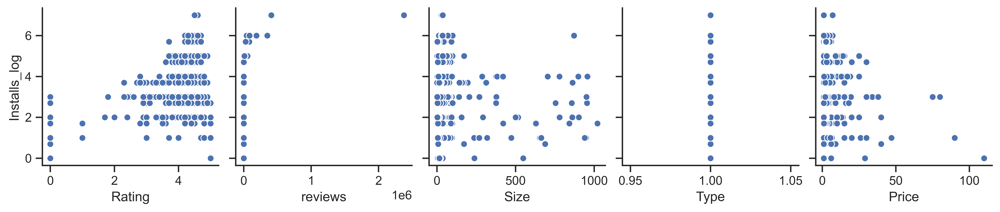

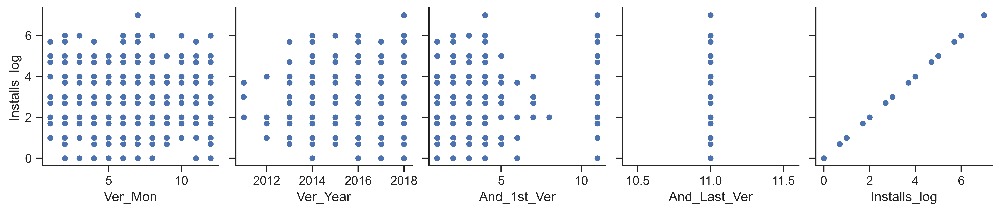

In [24]:
for i in range(0, len(df_paid_2.columns), 5):
    sns.pairplot(data=df_paid_2,
                 x_vars=df_paid_2.columns[i:i+5],
                 y_vars=['Installs_log']
                )

In [25]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Installs_log', data=df_paid_2[col], ax=ax)

In [26]:
df_paid_2.describe()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
count,775.000000,7.750000e+02,775.000000,775.0,775.000000,775.000000,775.000000,775.000000,769.0,775.000000
mean,3.487097,1.203819e+04,56.909935,1.0,5.240516,6.380645,2016.665806,3.990968,11.0,3.196890
std,1.731853,1.229865e+05,146.420266,0.0,8.798274,3.044186,1.562829,2.441813,0.0,1.456777
min,0.000000,0.000000e+00,1.000000,1.0,0.990000,1.000000,2011.000000,1.000000,11.0,0.000000
25%,3.450000,8.000000e+00,5.700000,1.0,1.490000,4.000000,2016.000000,2.000000,11.0,2.000000
50%,4.300000,1.040000e+02,20.000000,1.0,2.990000,6.000000,2017.000000,4.000000,11.0,3.000000
75%,4.600000,1.411000e+03,37.000000,1.0,4.990000,8.000000,2018.000000,4.000000,11.0,4.000000
max,5.000000,2.376564e+06,1020.000000,1.0,109.990000,12.000000,2018.000000,11.000000,11.0,7.000000


In [27]:
len(df_paid_2)

775

### 유료앱 $10 이하

In [28]:
df_paid_3 = df_paid.loc[df_paid.Price < 10]
df_paid_3.tail()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10695,5.0,2.0,16.0,1.0,0.99,3.0,2017.0,2.0,11.0,0.00000
10733,0.0,17.0,157.0,1.0,0.99,11.0,2015.0,2.0,11.0,2.00000
10758,4.4,35.0,2.4,1.0,7.99,8.0,2018.0,4.0,11.0,3.00000
10783,4.2,1405.0,9.5,1.0,1.20,6.0,2018.0,2.0,11.0,4.00000
10796,0.0,0.0,1020.0,1.0,1.04,2.0,2012.0,3.0,11.0,1.69897


In [29]:
df_paid_3.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [30]:
df_p3_corr = df_paid_3.corr()['Installs_log'][:-1]
features_list = df_p3_corr[abs(df_p3_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Installs_log:\n{}".format(len(features_list), features_list))

The following are the top 7 strongly correlated values with Installs_log:
Rating         0.627389
reviews        0.217698
And_1st_Ver    0.188763
Price          0.154611
Ver_Year       0.093134
Ver_Mon        0.061478
Size          -0.065930
Name: Installs_log, dtype: float64


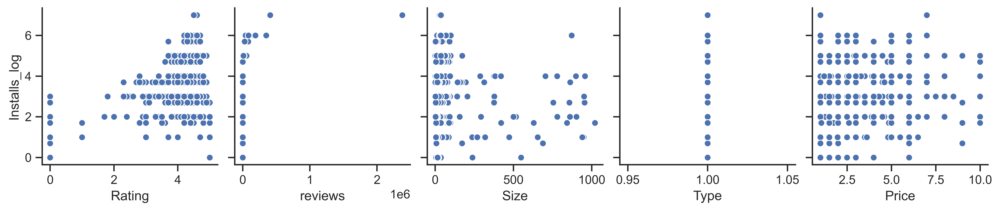

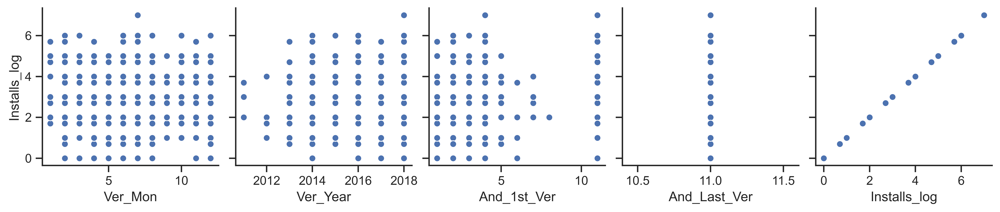

In [31]:
for i in range(0, len(df_paid_3.columns), 5):
    sns.pairplot(data=df_paid_3,
                 x_vars=df_paid_3.columns[i:i+5],
                 y_vars=['Installs_log']
                )

In [32]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Installs_log', data=df_paid_3[col], ax=ax)

In [33]:
df_paid_3.describe()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
count,704.000000,7.040000e+02,704.000000,704.0,704.000000,704.000000,704.000000,704.000000,698.0,704.000000
mean,3.488778,1.316928e+04,58.738068,1.0,3.248977,6.326705,2016.660511,4.001420,11.0,3.220030
std,1.735473,1.289922e+05,150.972587,0.0,2.167160,3.025463,1.574992,2.502061,0.0,1.472055
min,0.000000,0.000000e+00,1.000000,1.0,0.990000,1.000000,2011.000000,1.000000,11.0,0.000000
25%,3.475000,7.000000e+00,5.775000,1.0,1.490000,4.000000,2016.000000,2.000000,11.0,2.000000
50%,4.300000,1.250000e+02,20.000000,1.0,2.990000,6.000000,2017.000000,4.000000,11.0,3.000000
75%,4.600000,1.504000e+03,37.000000,1.0,4.490000,8.000000,2018.000000,4.000000,11.0,4.000000
max,5.000000,2.376564e+06,1020.000000,1.0,9.990000,12.000000,2018.000000,11.000000,11.0,7.000000


In [34]:
len(df_paid_3)

704

### 무료

In [35]:
df_free = df_1.loc[df_1.Price == 0]
df_free.tail()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
10834,4.5,38.0,53.0,0.0,0.0,7.0,2017.0,4.0,11.0,3.69897
10835,5.0,4.0,3.6,0.0,0.0,7.0,2018.0,4.0,11.0,2.00000
10836,0.0,3.0,9.5,0.0,0.0,1.0,2017.0,2.0,11.0,3.00000
10837,4.5,114.0,37.0,0.0,0.0,1.0,2015.0,11.0,11.0,3.00000
10838,4.5,398307.0,19.0,0.0,0.0,7.0,2018.0,11.0,11.0,7.00000


In [36]:
df_free.describe()

,Rating,reviews,Size,Type,Price,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log
count,10049.000000,1.004900e+04,10049.000000,10049.0,10049.0,10049.000000,10049.000000,10049.000000,10035.000000,10049.000000
mean,3.632152,4.781848e+05,35.424609,0.0,0.0,6.416857,2014.645537,4.694796,10.981166,5.013214
std,1.496777,3.038015e+06,84.414324,0.0,0.0,2.546986,75.260435,2.558179,0.426994,1.950419
min,0.000000,0.000000e+00,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.700000,4.500000e+01,6.900000,0.0,0.0,5.000000,2017.000000,4.000000,11.000000,3.698970
50%,4.200000,2.951000e+03,20.000000,0.0,0.0,7.000000,2018.000000,4.000000,11.000000,5.000000
75%,4.500000,6.660200e+04,37.000000,0.0,0.0,8.000000,2018.000000,4.000000,11.000000,6.698970
max,5.000000,7.815831e+07,994.000000,0.0,0.0,12.000000,2018.000000,11.000000,11.000000,9.000000


In [37]:
df_free.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [41]:
df_f_corr = df_free.corr()['Installs_log'][:-1]
features_list = df_f_corr[abs(df_f_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Installs_log:\n{}".format(len(features_list), features_list))

The following are the top 7 strongly correlated values with Installs_log:
Rating          0.600400
And_1st_Ver     0.326735
reviews         0.257194
Ver_Mon         0.109806
Ver_Year        0.098464
And_Last_Ver    0.091391
Size            0.023224
Name: Installs_log, dtype: float64


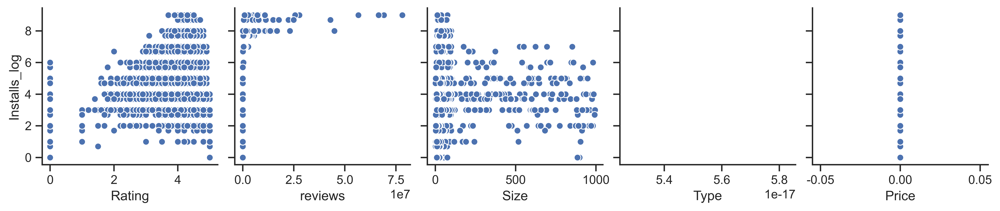

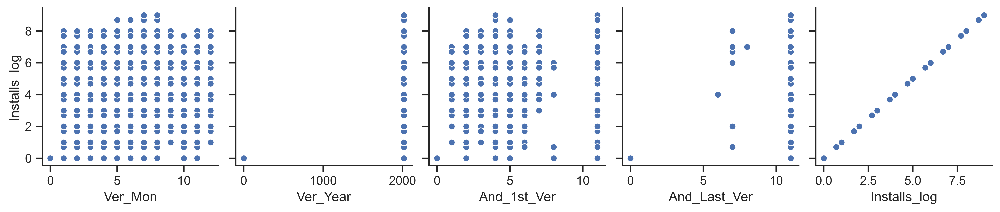

In [42]:
for i in range(0, len(df_free.columns), 5):
    sns.pairplot(data=df_free,
                 x_vars=df_free.columns[i:i+5],
                 y_vars=['Installs_log']
                )

In [40]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Installs_log', data=df_free[col], ax=ax)

### Price 기반 분석

In [43]:
col = ['Rating', 'reviews', 'Size', 'Type', 'Ver_Mon', 'Ver_Year', 'And_1st_Ver', 'And_Last_Ver', 'Installs_log', 'Price']

df_2 = df[col]
df_2.tail(1)

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
10838,4.5,398307.0,19.0,0.0,7.0,2018.0,11.0,11.0,7.0,0.0


In [44]:
df_2.describe()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
count,10839.000000,1.083900e+04,10839.000000,10839.000000,10839.000000,10839.000000,10839.000000,10819.000000,10839.000000,10839.000000
mean,3.622105,4.441939e+05,37.013073,0.072885,6.414153,2014.794169,4.643510,10.982531,4.881463,0.916252
std,1.514233,2.927893e+06,90.822287,0.259960,2.586426,72.468766,2.555032,0.411260,1.974904,14.814128
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.700000,3.800000e+01,6.800000,0.000000,5.000000,2017.000000,4.000000,11.000000,3.349485,0.000000
50%,4.200000,2.094000e+03,20.000000,0.000000,7.000000,2018.000000,4.000000,11.000000,5.000000,0.000000
75%,4.500000,5.478300e+04,37.000000,0.000000,8.000000,2018.000000,4.000000,11.000000,6.698970,0.000000
max,5.000000,7.815831e+07,1020.000000,1.000000,12.000000,2018.000000,11.000000,11.000000,9.000000,400.000000


In [45]:
df_2.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [46]:
df_2_corr = df_2.corr()['Price'][:-1]
features_list = df_2_corr[abs(df_2_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Price:\n{}".format(len(features_list), features_list))

The following are the top 9 strongly correlated values with Price:
Type            0.220601
Size            0.017400
And_Last_Ver    0.002625
Ver_Year        0.002134
Rating          0.000339
Ver_Mon         0.000189
reviews        -0.009271
And_1st_Ver    -0.015473
Installs_log   -0.046416
Name: Price, dtype: float64


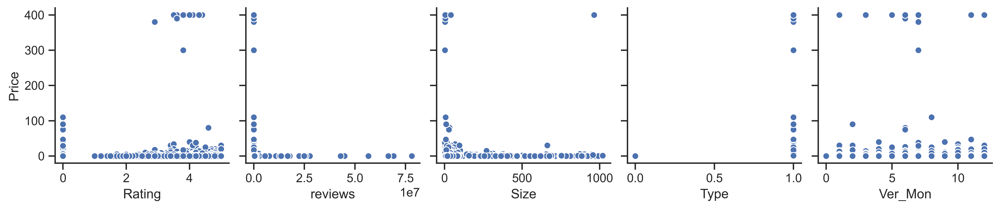

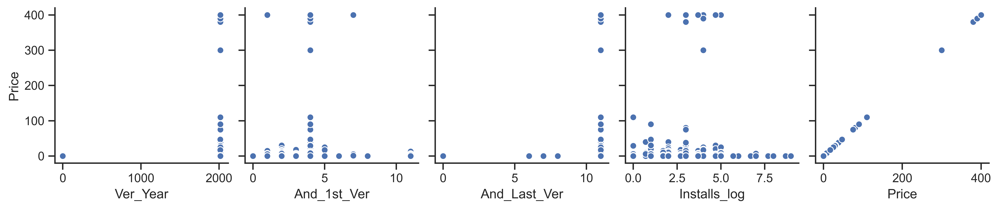

In [47]:
for i in range(0, len(df_2.columns), 5):
    sns.pairplot(data=df_2,
                 x_vars=df_2.columns[i:i+5],
                 y_vars=['Price']
                )

In [48]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Price', data=df_2[col], ax=ax)

### Outlier 제거

In [49]:
df_out = df_2.loc[df_2.Price < 250]
df_out.tail()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
10834,4.5,38.0,53.0,0.0,7.0,2017.0,4.0,11.0,3.69897,0.0
10835,5.0,4.0,3.6,0.0,7.0,2018.0,4.0,11.0,2.00000,0.0
10836,0.0,3.0,9.5,0.0,1.0,2017.0,2.0,11.0,3.00000,0.0
10837,4.5,114.0,37.0,0.0,1.0,2015.0,11.0,11.0,3.00000,0.0
10838,4.5,398307.0,19.0,0.0,7.0,2018.0,11.0,11.0,7.00000,0.0


In [50]:
df_out.describe()

,Rating,reviews,Size,Type,Ver_Mon,Ver_Year,And_1st_Ver,And_Last_Ver,Installs_log,Price
count,10824.000000,1.082400e+04,10824.000000,10824.000000,10824.000000,10824.000000,10824.000000,10804.000000,10824.000000,10824.000000
mean,3.621766,4.448086e+05,36.962962,0.071600,6.414265,2014.790188,4.644401,10.982506,4.883165,0.375222
std,1.515193,2.929874e+06,90.440044,0.257837,2.585620,72.518886,2.556365,0.411545,1.975556,2.713233
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.700000,3.800000e+01,6.800000,0.000000,5.000000,2017.000000,4.000000,11.000000,3.698970,0.000000
50%,4.200000,2.107000e+03,20.000000,0.000000,7.000000,2018.000000,4.000000,11.000000,5.000000,0.000000
75%,4.500000,5.501175e+04,37.000000,0.000000,8.000000,2018.000000,4.000000,11.000000,6.698970,0.000000
max,5.000000,7.815831e+07,1020.000000,1.000000,12.000000,2018.000000,11.000000,11.000000,9.000000,109.990000


In [51]:
df_out.hist(figsize=(15, 20), bins=50, xlabelsize=8, ylabelsize=8);

In [52]:
df_out_corr = df_out.corr()['Price'][:-1]
features_list = df_out_corr[abs(df_out_corr) > 0].sort_values(ascending=False)
print("The following are the top {} strongly correlated values with Price:\n{}".format(len(features_list), features_list))

The following are the top 9 strongly correlated values with Price:
Type            0.498002
Size            0.012249
Ver_Mon         0.008285
And_Last_Ver    0.005860
Ver_Year        0.003770
reviews        -0.020419
Rating         -0.031025
And_1st_Ver    -0.034287
Installs_log   -0.129088
Name: Price, dtype: float64


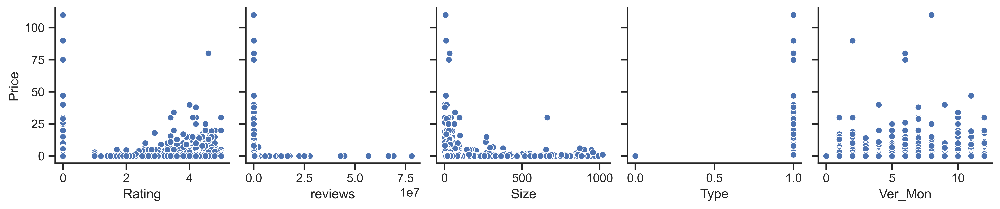

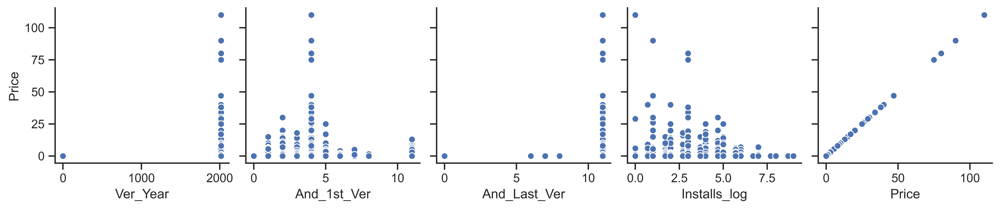

In [53]:
for i in range(0, len(df_out.columns), 5):
    sns.pairplot(data=df_out,
                 x_vars=df_out.columns[i:i+5],
                 y_vars=['Price']
                )

In [54]:
fig, ax = plt.subplots(round(len(col) / 3), 3, figsize= (18, 12))

for i, ax in enumerate(fig.axes):
    if i < len(col) - 1:
        sns.regplot(x = col[i], y='Price', data=df_out[col], ax=ax)